In [1]:
# Lidar data source = http://www.cvlibs.net/datasets/kitti/
# Lidar data Viz -- https://www.youtube.com/watch?v=AcU3fJJtr7Q
# Raw Data == http://www.cvlibs.net/datasets/kitti/raw_data.php
# Kitti on Kaggle = https://www.kaggle.com/c/3d-object-detection-for-autonomous-vehicles/discussion/109072
# https://www.kaggle.com/stalkermustang/converting-lyft-dataset-to-kitty-format

import numpy as np
import pykitti
import vtk
import mayavi 
# Chose which visualization library to use:  "mayavi" or "matplotlib"
VISLIB = "mayavi"
#VISLIB = "matplotlib"

In [3]:
# Using caliberated data == https://s3.eu-central-1.amazonaws.com/avg-kitti/raw_data/2011_09_26_calib.zip

basedir = '/home/dhankar/_dc_all/lidar/lidar/'
date = '2011_09_26'
drive = '0001'

dataset = pykitti.raw(basedir, date, drive)#, frame_range)
print(type(dataset))
print(len(dataset))



<class 'pykitti.raw.raw'>
108


In [4]:
# Following == navoshta_KITTI-Dataset-master
# Source == https://github.com/navoshta/KITTI-Dataset/blob/master/kitti-dataset.ipynb

# Change this to the directory where you store KITTI data
basedir = '/home/dhankar/_dc_all/lidar/lidar/'

In [24]:
# Following == navoshta_KITTI-Dataset-master
# Source == https://github.com/navoshta/KITTI-Dataset/blob/master/kitti-dataset.ipynb


def load_dataset(date=None, drive=None, calibrated=False, frame_range=None):
    """
    Loads the dataset with `date` and `drive`.
    
    Parameters
    ----------
    date        : Dataset creation date. DHANK- Defaults to `None`#HardCoded Below
    drive       : Dataset drive.         DHANK- Defaults to `None`#HardCoded Below
    calibrated  : Flag indicating if we need to parse calibration data. Defaults to `False`.
    frame_range : Range of frames. Defaults to `None`.

    Returns
    -------
    Loaded dataset of type `raw`.
    """
    date = '2011_09_26'
    drive = '0001'
    dataset = pykitti.raw(basedir, date, drive)
    #print(dataset) # OK
    #calib_data_what_is = dataset.load_calib()
    #print(type(calib_data_what_is)) 
    # DHANK - above Line == AttributeError: 'raw' object has no attribute 'load_calib'
    #
    calib_whatIs = dataset.calib.T_velo_imu
    print(type(calib_whatIs)) # <class 'numpy.ndarray'>
    print(calib_whatIs.shape) # (4, 4)
    print(calib_whatIs)
    
    #str_calib_whatIs = str(dataset.calib.T_velo_imu)
    #print(type(str_calib_whatIs))
    #print(str_calib_whatIs)

    # Load the data
    if calibrated:
        dataset.load_calib()  # Calibration data are accessible as named tuples
    
    np.set_printoptions(precision=4, suppress=True)
    print('\nDrive: ' + str(dataset.drive))
    print('\nFrame range: ' + str(dataset.frames))

    if calibrated:
        print('\nIMU-to-Velodyne transformation:\n' + str(dataset.calib.T_velo_imu))
        print('\nGray stereo pair baseline [m]: ' + str(dataset.calib.b_gray))
        print('\nRGB stereo pair baseline [m]: ' + str(dataset.calib.b_rgb))

    return dataset
        
        
load_dataset()        

<class 'numpy.ndarray'>
(4, 4)
[[ 1.      0.0008 -0.002  -0.8087]
 [-0.0008  0.9999 -0.0148  0.3196]
 [ 0.002   0.0148  0.9999 -0.7997]
 [ 0.      0.      0.      1.    ]]

Drive: 2011_09_26_drive_0001_sync

Frame range: None


In [25]:
len_data_velo = len(list(dataset.velo))
print(len_data_velo)

108


In [36]:
# Following == navoshta_KITTI-Dataset-master
# Source == https://github.com/navoshta/KITTI-Dataset/blob/master/kitti-dataset.ipynb


import parseTrackletXML as xmlParser

def load_tracklets_for_frames(n_frames, xml_path):
    """
    Loads dataset labels also referred to as tracklets, 
    saving them individually for each frame.

    Parameters
    ----------
    n_frames    : Number of frames in the dataset.
    xml_path    : Path to the tracklets XML.

    Returns
    -------
    Tuple of dictionaries with integer keys corresponding to absolute 
    frame numbers and arrays as values. First array
    contains coordinates of bounding box vertices for each object in the frame, and the second array contains objects
    types as strings.
    """
    tracklets = xmlParser.parseXML(xml_path)
    # xml_path == '/home/dhankar/_dc_all/lidar/lidar/2011_09_26/2011_09_26_drive_0001_sync/tracklet_labels.xml'
    #print("----tracklets---AA---",tracklets) # Dhankar - OK - 
    """
    <parseTrackletXML.Tracklet object at 0x7f1caef7caf0>, 
    <parseTrackletXML.Tracklet object at 0x7f1caef7c8b0>,
    <parseTrackletXML.Tracklet object at 0x7f1caef7cb20>, etc ....
    """
    

    frame_tracklets = {}
    frame_tracklets_types = {}
    for i in range(n_frames):
        frame_tracklets[i] = []
        frame_tracklets_types[i] = []
    # loop over tracklets
    for i, tracklet in enumerate(tracklets):
        # this part is inspired by kitti object development kit matlab code: computeBox3D
        h, w, l = tracklet.size
        # in velodyne coordinates around zero point and without orientation yet
        trackletBox = np.array([
            [-l / 2, -l / 2, l / 2, l / 2, -l / 2, -l / 2, l / 2, l / 2],
            [w / 2, -w / 2, -w / 2, w / 2, w / 2, -w / 2, -w / 2, w / 2],
            [0.0, 0.0, 0.0, 0.0, h, h, h, h]
        ])
        # loop over all data in tracklet
        for translation, rotation, state, occlusion, truncation, amtOcclusion, amtBorders, absoluteFrameNumber in tracklet:
            # determine if object is in the image; otherwise continue
            if truncation not in (xmlParser.TRUNC_IN_IMAGE, xmlParser.TRUNC_TRUNCATED):
                continue
            # re-create 3D bounding box in velodyne coordinate system
            yaw = rotation[2]  # other rotations are supposedly 0
            assert np.abs(rotation[:2]).sum() == 0, 'object rotations other than yaw given!'
            rotMat = np.array([
                [np.cos(yaw), -np.sin(yaw), 0.0],
                [np.sin(yaw), np.cos(yaw), 0.0],
                [0.0, 0.0, 1.0]
            ])
            cornerPosInVelo = np.dot(rotMat, trackletBox) + np.tile(translation, (8, 1)).T
            frame_tracklets[absoluteFrameNumber] = frame_tracklets[absoluteFrameNumber] + [cornerPosInVelo]
            frame_tracklets_types[absoluteFrameNumber] = frame_tracklets_types[absoluteFrameNumber] + [
                tracklet.objectType]
            
    return (frame_tracklets, frame_tracklets_types)


In [38]:
#/home/dhankar/_dc_all/lidar/lidar/2011_09_26/2011_09_26_drive_0001_sync   
# drive = 2011_09_26_drive_0001_sync

tracklet_rects, tracklet_types = load_tracklets_for_frames(len(list(dataset.velo)),'/home/dhankar/_dc_all/lidar/lidar/2011_09_26/2011_09_26_drive_0001_sync/tracklet_labels.xml')        
#print(tracklet_rects)
print(tracklet_types)

"""
Looking at the points distributions, we could catch something meaningful if we limit X, Y and Z axis to some magic numbers.

Additionally we will only visualise 20% of the point cloud, as each frame contains ~120K points.

"""



Parsing tracklet file /home/dhankar/_dc_all/lidar/lidar/2011_09_26/2011_09_26_drive_0001_sync/tracklet_labels.xml
File contains 15 tracklets
Loaded 15 tracklets.
{0: ['Car', 'Car', 'Car', 'Tram', 'Car'], 1: ['Car', 'Car', 'Car', 'Tram', 'Car'], 2: ['Car', 'Car', 'Car', 'Tram', 'Car'], 3: ['Car', 'Car', 'Car', 'Tram', 'Car'], 4: ['Car', 'Car', 'Car', 'Tram', 'Car'], 5: ['Car', 'Car', 'Car', 'Tram', 'Car'], 6: ['Car', 'Car', 'Car', 'Tram', 'Car'], 7: ['Car', 'Car', 'Car', 'Tram', 'Car'], 8: ['Car', 'Car', 'Car', 'Tram', 'Car', 'Car'], 9: ['Car', 'Car', 'Car', 'Tram', 'Car', 'Car'], 10: ['Car', 'Car', 'Car', 'Tram', 'Car', 'Car', 'Car'], 11: ['Car', 'Car', 'Car', 'Tram', 'Car', 'Car', 'Car'], 12: ['Car', 'Car', 'Car', 'Tram', 'Car', 'Car', 'Car'], 13: ['Car', 'Car', 'Tram', 'Car', 'Car', 'Car'], 14: ['Car', 'Car', 'Tram', 'Car', 'Car', 'Car', 'Car'], 15: ['Car', 'Car', 'Tram', 'Car', 'Car', 'Car', 'Car'], 16: ['Car', 'Car', 'Tram', 'Car', 'Car', 'Car', 'Car'], 17: ['Car', 'Car', 'Tram', '

In [39]:
# Following == navoshta_KITTI-Dataset-master
# Source == https://github.com/navoshta/KITTI-Dataset/blob/master/kitti-dataset.ipynb


import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

colors = {
    'Car': 'b',
    'Tram': 'r',
    'Cyclist': 'g',
    'Van': 'c',
    'Truck': 'm',
    'Pedestrian': 'y',
    'Sitter': 'k'
}
axes_limits = [
    [-20, 80], # X axis range
    [-20, 20], # Y axis range
    [-3, 10]   # Z axis range
]

axes_str = ['X', 'Y', 'Z']

def draw_box(pyplot_axis, vertices, axes=[0, 1, 2], color='black'):
    """
    Draws a bounding 3D box in a pyplot axis.
    Parameters
    ----------
    pyplot_axis : Pyplot axis to draw in.
    vertices    : Array 8 box vertices containing x, y, z coordinates.
    axes        : Axes to use. Defaults to `[0, 1, 2]`, e.g. x, y and z axes.
    color       : Drawing color. Defaults to `black`.
    """
    vertices = vertices[axes, :]
    connections = [
        [0, 1], [1, 2], [2, 3], [3, 0],  # Lower plane parallel to Z=0 plane
        [4, 5], [5, 6], [6, 7], [7, 4],  # Upper plane parallel to Z=0 plane
        [0, 4], [1, 5], [2, 6], [3, 7]  # Connections between upper and lower planes
    ]
    for connection in connections:
        pyplot_axis.plot(*vertices[:, connection], c=color, lw=0.5)
        
    
    

In [40]:
# Following == navoshta_KITTI-Dataset-master
# Source == https://github.com/navoshta/KITTI-Dataset/blob/master/kitti-dataset.ipynb


def display_frame_statistics(dataset, tracklet_rects, tracklet_types, frame, points=0.2):
    """
    Displays statistics for a single frame. Draws camera data, 3D plot of the lidar point cloud data and point cloud
    projections to various planes.
    
    Parameters
    ----------
    dataset         : `raw` dataset.
    tracklet_rects  : Dictionary with tracklet bounding boxes coordinates.
    tracklet_types  : Dictionary with tracklet types.
    frame           : Absolute number of the frame.
    points          : Fraction of lidar points to use. Defaults to `0.2`, e.g. 20%.
    """
    dataset_gray = list(dataset.gray)
    dataset_rgb = list(dataset.rgb)
    dataset_velo = list(dataset.velo)
    
    print('Frame timestamp: ' + str(dataset.timestamps[frame]))
    # Draw camera data
    f, ax = plt.subplots(2, 2, figsize=(15, 5))
    ax[0, 0].imshow(dataset_gray[frame][0], cmap='gray')
    ax[0, 0].set_title('Left Gray Image (cam0)')
    ax[0, 1].imshow(dataset_gray[frame][1], cmap='gray')
    ax[0, 1].set_title('Right Gray Image (cam1)')
    ax[1, 0].imshow(dataset_rgb[frame][0])
    ax[1, 0].set_title('Left RGB Image (cam2)')
    ax[1, 1].imshow(dataset_rgb[frame][1])
    ax[1, 1].set_title('Right RGB Image (cam3)')
    plt.show()

    points_step = int(1. / points)
    point_size = 0.01 * (1. / points)
    velo_range = range(0, dataset_velo[frame].shape[0], points_step)
    velo_frame = dataset_velo[frame][velo_range, :]      
    def draw_point_cloud(ax, title, axes=[0, 1, 2], xlim3d=None, ylim3d=None, zlim3d=None):
        """
        Convenient method for drawing various point cloud projections as a part of frame statistics.
        """
        ax.scatter(*np.transpose(velo_frame[:, axes]), s=point_size, c=velo_frame[:, 3], cmap='gray')
        ax.set_title(title)
        ax.set_xlabel('{} axis'.format(axes_str[axes[0]]))
        ax.set_ylabel('{} axis'.format(axes_str[axes[1]]))
        if len(axes) > 2:
            ax.set_xlim3d(*axes_limits[axes[0]])
            ax.set_ylim3d(*axes_limits[axes[1]])
            ax.set_zlim3d(*axes_limits[axes[2]])
            ax.set_zlabel('{} axis'.format(axes_str[axes[2]]))
        else:
            ax.set_xlim(*axes_limits[axes[0]])
            ax.set_ylim(*axes_limits[axes[1]])
        # User specified limits
        if xlim3d!=None:
            ax.set_xlim3d(xlim3d)
        if ylim3d!=None:
            ax.set_ylim3d(ylim3d)
        if zlim3d!=None:
            ax.set_zlim3d(zlim3d)
            
        for t_rects, t_type in zip(tracklet_rects[frame], tracklet_types[frame]):
            draw_box(ax, t_rects, axes=axes, color=colors[t_type])
            
    # Draw point cloud data as 3D plot
    f2 = plt.figure(figsize=(15, 8))
    ax2 = f2.add_subplot(111, projection='3d')                    
    draw_point_cloud(ax2, 'Velodyne scan', xlim3d=(-10,30))
    plt.show()
    
    # Draw point cloud data as plane projections
    f, ax3 = plt.subplots(3, 1, figsize=(15, 25))
    draw_point_cloud(
        ax3[0], 
        'Velodyne scan, XZ projection (Y = 0), the car is moving in direction left to right', 
        axes=[0, 2] # X and Z axes
    )
    draw_point_cloud(
        ax3[1], 
        'Velodyne scan, XY projection (Z = 0), the car is moving in direction left to right', 
        axes=[0, 1] # X and Y axes
    )
    draw_point_cloud(
        ax3[2], 
        'Velodyne scan, YZ projection (X = 0), the car is moving towards the graph plane', 
        axes=[1, 2] # Y and Z axes
    )
    plt.show()
    
    

Frame timestamp: 2011-09-26 13:02:27.004432


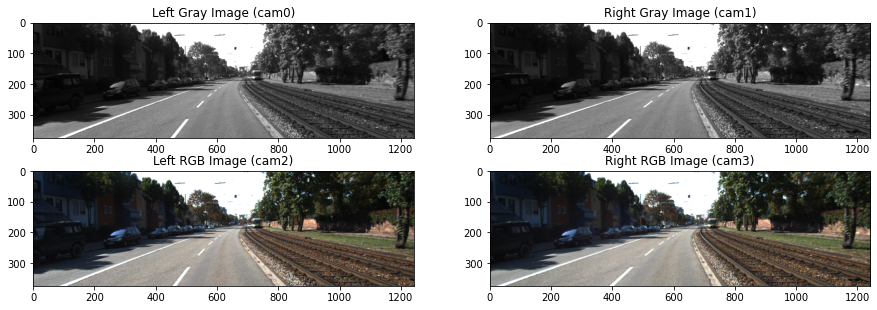

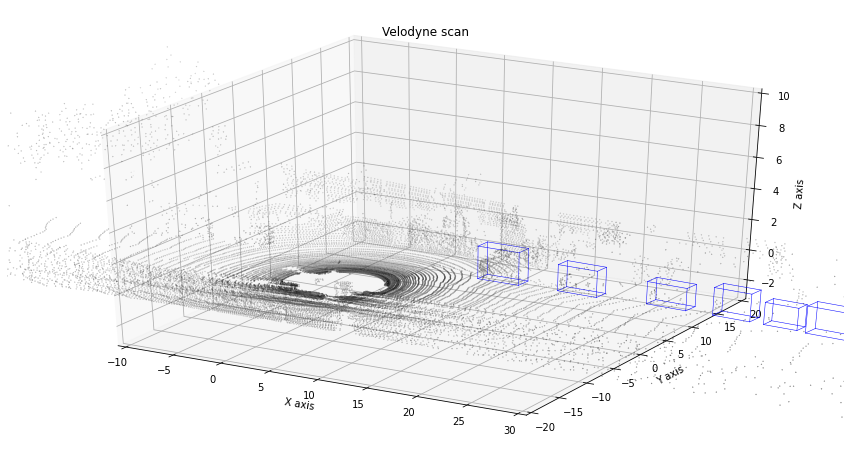

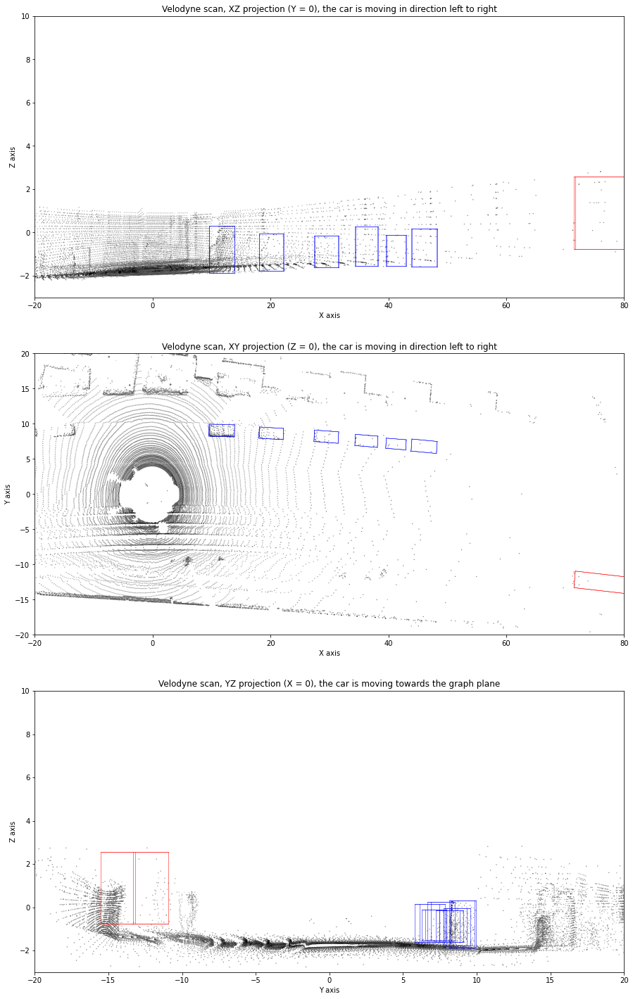

In [41]:
frame = 10

display_frame_statistics(dataset, tracklet_rects, tracklet_types, frame)



In [45]:
from utilities import print_progress
from moviepy.editor import ImageSequenceClip

def draw_3d_plot(frame, dataset, tracklet_rects, tracklet_types, points=0.2):
    """
    Saves a single frame for an animation: a 3D plot of the lidar data 
    without ticks and all frame trackelts.
    
    Parameters
    ----------
    frame           : Absolute number of the frame.
    dataset         : `raw` dataset.
    tracklet_rects  : Dictionary with tracklet bounding boxes coordinates.
    tracklet_types  : Dictionary with tracklet types.
    points          : Fraction of lidar points to use. Defaults to `0.2`, e.g. 20%.

    Returns
    -------
    Saved frame filename.
    """
    dataset_velo = list(dataset.velo)
    
    f = plt.figure(figsize=(12, 8))
    axis = f.add_subplot(111, projection='3d', xticks=[], yticks=[], zticks=[])

    points_step = int(1. / points)
    point_size = 0.01 * (1. / points)
    velo_range = range(0, dataset_velo[frame].shape[0], points_step)
    velo_frame = dataset_velo[frame][velo_range, :]
    axis.scatter(*np.transpose(velo_frame[:, [0, 1, 2]]), s=point_size, c=velo_frame[:, 3], cmap='gray')
    axis.set_xlim3d(*axes_limits[0])
    axis.set_ylim3d(*axes_limits[1])
    axis.set_zlim3d(*axes_limits[2])
    print("===========AAAAAAAA=============")
    for t_rects, t_type in zip(tracklet_rects[frame], tracklet_types[frame]):
        draw_box(axis, t_rects, axes=[0, 1, 2], color=colors[t_type])
    filename = 'video/frame_{0:0>4}.png'.format(frame)
    plt.savefig(filename)
    plt.close(f)
    return filename

frames = []
n_frames = len(list(dataset.velo))

print('Preparing animation frames...')
for i in range(n_frames):
    print_progress(i, n_frames - 1)
    filename = draw_3d_plot(i, dataset, tracklet_rects, tracklet_types)
    frames += [filename]
print('...Animation frames ready.')

clip = ImageSequenceClip(frames, fps=5)
#% time
clip.write_gif('pcl_data.gif', fps=5)

Preparing animation frames...
 |----------------------------------------------------------------------------------------------------| 0%===========AAAAAAAA=============
 |█---------------------------------------------------------------------------------------------------| 1%===========AAAAAAAA=============
 |██--------------------------------------------------------------------------------------------------| 2%===========AAAAAAAA=============
 |███-------------------------------------------------------------------------------------------------| 3%===========AAAAAAAA=============
 |████------------------------------------------------------------------------------------------------| 4%===========AAAAAAAA=============
 |█████-----------------------------------------------------------------------------------------------| 5%===========AAAAAAAA=============
 |██████----------------------------------------------------------------------------------------------| 6%===========AAAAAAAA===========

 |██████████████████████████████████████████████████████----------------------------------------------| 54%===========AAAAAAAA=============
 |███████████████████████████████████████████████████████---------------------------------------------| 55%===========AAAAAAAA=============
 |████████████████████████████████████████████████████████--------------------------------------------| 56%===========AAAAAAAA=============
 |█████████████████████████████████████████████████████████-------------------------------------------| 57%===========AAAAAAAA=============
 |██████████████████████████████████████████████████████████------------------------------------------| 58%===========AAAAAAAA=============
 |███████████████████████████████████████████████████████████-----------------------------------------| 59%===========AAAAAAAA=============
 |████████████████████████████████████████████████████████████----------------------------------------| 60%===========AAAAAAAA=============
 |██████████████████

t:   4%|▎         | 4/108 [00:00<00:02, 34.87it/s, now=None]

MoviePy - Building file pcl_data.gif with imageio.


In [6]:
# Load Lidar Data
velo_1 = dataset.get_velo(9)    # Each scan is a Nx4 array of [x,y,z,reflectance]
## this is the file == 0000000009.bin 
## Local Path of File == lidar/2011_09_26/2011_09_26_drive_0001_sync/velodyne_points/data/0000000009.bin
print(type(velo_1))
print(velo_1.shape)

<class 'numpy.ndarray'>
(122402, 4)


In [7]:
# Load Lidar Data
velo_1 = dataset.get_velo(10)    # Each scan is a Nx4 array of [x,y,z,reflectance]
## this is the file == 00000000010.bin 
print(type(velo_1))
print(velo_1.shape)

<class 'numpy.ndarray'>
(122486, 4)


In [16]:

# Plot using mayavi -Much faster and smoother than matplotlib
import mayavi.mlab
    
fig = mayavi.mlab.figure(bgcolor=(0, 0, 0), size=(640, 360))
mayavi.mlab.points3d(
    velo_1[:, 0],   # x
    velo_1[:, 1],   # y
    velo_1[:, 2],   # z
    velo_1[:, 2],   # Height data used for shading
    mode="point", # How to render each point {'point', 'sphere' , 'cube' }
    colormap='spectral',  # 'bone', 'copper',
    #color=(0, 1, 0),     # Used a fixed (r,g,b) color instead of colormap
    scale_factor=100,     # scale of the points
    line_width=10,        # Scale of the line, if any
    figure=fig,
)
# velo[:, 3], # reflectance values
mayavi.mlab.show()

/home/dhankar/anaconda3/envs/tensorflow_gpuenv/lib/python3.8/site-packages/vtk/numpy_interface/algorithms.py:206: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if max_dims is 1:


RuntimeError: No tvtk.toolkits plugin found for toolkit null

In [8]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

from PIL import Image
import io

In [12]:
fig = plt.figure(figsize=(25,25),dpi=900)
ax = fig.add_subplot(111, projection='3d')
velo_range = range(0, velo_1.shape[0])#, skip) # could skip points to prevent crash
ax.scatter(velo_1[velo_range, 1],   # x
           velo_1[velo_range, 2],   # y
           velo_1[velo_range, 0],   # z
           c=velo_1[velo_range, 3], # reflectance
           s=2,
           cmap='ocean')
ax.set_title('Lidar scan - MATPLOTLIB - Wish it was MAYAVI')
plt.show()


In [17]:
from mayavi import mlab

RuntimeError: No tvtk.toolkits plugin found for toolkit null